## Natural Language Processing with RNNs 

### Project and Dataset information


This dataset contains the a csv file transcript of the Apple event live stream held in September 2023. It includes three fields: "Text," representing the verbatim transcript; "Start Time," indicating when each segment of text begins; and "Duration," specifying the duration of each spoken segment.
There are 1349 rows and 3 columns with no null value. Only text column is used for this script character RNN project to predict the next token.


Reference: https://www.kaggle.com/datasets/nuhmanpk/apple-event-september-2023-transcript

### Import functions

In [1]:
# Collapse-show
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 2.x
    IS_COLAB = True
except Exception:
    IS_COLAB = False

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.callbacks import EarlyStopping
assert tf.__version__ >= "2.0"

if not tf.test.is_gpu_available():
    print("No GPU was detected. LSTMs and CNNs can be very slow without a GPU.")
    if IS_COLAB:
        print("Go to Runtime > Change runtime and select a GPU hardware accelerator.")

# Common imports
import numpy as np
import pandas as pd
import os

# to make this notebook's output stable across runs
np.random.seed(42)
tf.random.set_seed(42)

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "rnn"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings('ignore')

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.
No GPU was detected. LSTMs and CNNs can be very slow without a GPU.


## Load and Explore Data

In [2]:
data = pd.read_csv('scb_mt_enth_2020_test.csv') # load csv dataset
data.tail(10) # Check data from the last 10 rows

,Unnamed: 0,subdataset,en,th
100167,100167,thai_websites,CLARINS The antioxidant high-protection tinted...,CLARINS ทิ้นท์ชนิดเหลวที่ปกป้องผิวเป็นพิเศษด้ว...
100168,100168,generated_reviews_yn,You will definitely clean them up!,แน่นอนคุณจะทําความสะอาดพวกเขา!
100169,100169,task_master_1,"got it, let me search options for you.",รับทราบค่ะ ขอตรวจหาตัวเลือกที่ตีงตามความต้องกา...
100170,100170,task_master_1,"no, i also need three of the 2 liter bottles o...",ขอน้ําสไปร์ทขวดละ 2 ลิตรสามขวดด้วยค่ะ
100171,100171,task_master_1,Of course I can get you coffee! There's a Star...,แน่นอนค่ะ หนูซื้อกาแฟให้ได้ มีสตาร์บัคส์และพีท...
100172,100172,generated_reviews_yn,I didn't really care for the item.,ฉันไม่ได้สนใจรายการ
100173,100173,generated_reviews_yn,Worth a watch!,คุ้มค่ากับการดู!
100174,100174,wikipedia,Section::::Paralympics. Sitting volleyball was...,วอลเลย์บอลนั่ง () บางครั้งเรียกในชื่อ วอลเลย์บ...
100175,100175,nus_sms,Haha no just saying! Btw don't open the front ...,ฮะฮ่าไม่แค่พูดอ่ะ ยังไงก็ตามไม่เปิดข้างหน้าอาจ...
100176,100176,generated_reviews_yn,"Well done, Samsung!",ทําได้ดีมาก Samsung!


In [3]:
data.info # Check summary of the dataset

<bound method DataFrame.info of         Unnamed: 0                    subdataset  \
0                0  generated_reviews_translator   
1                1                 task_master_1   
2                2                       nus_sms   
3                3                 thai_websites   
4                4                     paracrawl   
...            ...                           ...   
100172      100172          generated_reviews_yn   
100173      100173          generated_reviews_yn   
100174      100174                     wikipedia   
100175      100175                       nus_sms   
100176      100176          generated_reviews_yn   

                                                       en  \
0                      These are good for using at night.   
1                                         It's Max Smith.   
2       please bring your labcoat today.give me a miss...   
3                        Scotch-Brite XN002033480 Wet Mop   
4       Coupon Detail 500 units for co

In [4]:
data.isnull().sum() # Check how many null value

Unnamed: 0    0
subdataset    0
en            0
th            0
dtype: int64

In [5]:
print(data.th[40:50]) # Print only text column from row 40 to 50

40    กระดาษคาร์บอน ชนิดเขียน สีน้ําเงิน กลาง ตราม้า...
41    หน่วยบัญชาการกองกําลังระดมพลจะตั้งอยู่ที่กองบั...
42    "ผู้บริโภคชาวจีนเชื่อถือผลิตภัณฑ์อาหารนําเข้าม...
43    ฉันเล่นเกมมาแล้ว แต่ฉันซื้อมาเพื่อวันหนึ่งฉันส...
44    นี่จะต้องเป็นเครื่องฟอกอากาศที่ดีที่สุด: สะอาด...
45    ฉันค้นหาตัวกรองสํารองเพื่อไม่ให้ตัวกรองดั้งเดิ...
46    ฉันชอบความคิดนี้เพราะมันแตกต่างจากส่วนใหญ่ แต่...
47                              แต่เป็นคนที่ฉลาดคนหนึ่ง
48    ฉันมีความสุขกับเนื้อเรื่อง แต่บางเรื่องก็ไกลเก...
49    แต่เกิดอะไรขึ้นกับตัวละครตัวที่สองหลังจากเขาสู...
Name: th, dtype: object


## Creating the Training Dataset

In [6]:
df = pd.DataFrame(data)
df['th'] = df['th'].str.lower() # convert all text into lowercase

In [7]:
newData = df['th'].iloc[0:].str.cat(sep=' ') # concat all texts from text column
newData # Display text

'ของพวกนี้ดีต่อการใช้งานตอนกลางคืน แม็กซ์ สมิธค่ะ ช่วยเอาเสื้อโค๊ตห้องแลปของเธอมาทีนะวันนี้ มิสคอลหาฉันหรือข้อความเมื่อเธออกนะ ม็อบเปียกซับน้ําดีเยี่ยม สก๊อตช์-ไบรต์ xn002033480 500 หน่วยสําหรับคูปองสําหรับการสั่งซื้อ joybuy ใด ๆ! เยี่ยมค่ะ พร้อมให้ไปรับใน 30 นาทีนะคะ ร้านที่เจอนะคะ ร้านแรกที่ดีกว่าชื่อดอน พิสโตส ได้เรตติ้งเยอะกว่า ร้านที่สองชื่อทรอปิซเวโญ่ค่ะ ฉันอยู่ในโฮโบเคน นิวเจอร์ซีย์ค่ะ เนื่องด้วยความมั่นใจเกินไปจากการเอาชนะญี่ปุ่นได้ทําให้หลี่ หรู้ซุ้งนํากองทหารองครักษ์ 5,000 นายและทหารเกาหลีอาสากลุ่มเล็กไล่ตามกองทัพญี่ปุ่นไปโดยพลการ อันเป็นเหตุเขาถูกทหาร 40,000 นายลอบซุ่มโจมตี หลี่ หรูซุ้งสามารถฝ่าวงล้อมออกมาได้เมื่อกําลังหนุน 5,000 นายเดินทางมาช่วยเหลือ และฝ่ายญี่ปุ่นก็ถอยออกนอกเขตเปียงยางอย่างเป็นทางการ ฉันต้องการสั่งพิซซ่าถาดใหญ่ร้านเบอร์ตุชชี ความจริงนานกว่าปกตินะคะ เป็นเพราะช่วงเวลานี้เป็นช่วงรถติดค่ะ เขาไม่ได้ใช้มัน เมื่อหนังสือเล่มนี้จบลงในที่สุด (โดยไม่มีเหตุการณ์สําคัญสูงสุด และ มีจุดหักมุมตอนจบที่น่าขัน) มันก็ไม่มีอะไรที่ทําให้ชั้นรู้สึกตื่นเต้นหรือสนุกไปกับมันเลยค่ะ 

In [8]:
# Split text by character-level tokenization and set all characters to lowercase
text_vec_layer = tf.keras.layers.TextVectorization(split="character", standardize="lower")

# Adapt the TextVectorization layer to the data in "newData" to learn the vocabulary
text_vec_layer.adapt([newData]) 

# Store encoded text data in "newData" using the adapted TextVectorization layer
encoded = text_vec_layer([newData])[0] 

In [9]:
encoded -= 2  # Drop tokens 0 (pad) and 1 (unknown), which we will not use
n_tokens = text_vec_layer.vocabulary_size() - 2  # Number of distinct characters
dataset_size = len(encoded)  # Total number of characters

In [10]:
n_tokens # Represent  distinct characters

523

In [11]:
dataset_size # Total number of characters

13388314

In [12]:
# Function to prepare sequences for training by converting them into a suitable TensorFlow 
# dataset format with batching, shuffling, and target creation. 
def to_dataset(sequence, length, shuffle=False, seed=None, batch_size=32):
    ds = tf.data.Dataset.from_tensor_slices(sequence)
    ds = ds.window(length + 1, shift=1, drop_remainder=True)
    ds = ds.flat_map(lambda window_ds: window_ds.batch(length + 1))
    if shuffle:
        ds = ds.shuffle(6_000, seed=seed)
    ds = ds.batch(batch_size)
    return ds.map(lambda window: (window[:, :-1], window[:, 1:])).prefetch(1)

In [13]:
# Convert a text input into a dataset of fixed-length sequences using TextVectorization.
list(to_dataset(text_vec_layer(["ที่"])[0], length=6))

[]

In [14]:
length = 100 # Set the learning character lenght to 100
tf.random.set_seed(42) # Generate random numbers and ensure reproducibility on CPU
train_set = to_dataset(encoded[:54_000], length=length, shuffle=True, # ~90% of the dataset is used for Training set
                       seed=42)
valid_set = to_dataset(encoded[54_000:57_000], length=length) # ~5% of the dataeet is used for Validation set
test_set = to_dataset(encoded[57_000:], length=length) # ~5% of the dataeet is used for Test set

## Building and Training the char-RNN Model

In [16]:
tf.random.set_seed(42) # Generate random numbers and ensure reproducibility on CPU

# Define the neural network model
model = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_tokens, output_dim=16),
    tf.keras.layers.GRU(128, return_sequences=True),
    tf.keras.layers.Dense(n_tokens, activation="softmax")
])

# Compile the model with loss, optimizer, and metrics
model.compile(loss="sparse_categorical_crossentropy", optimizer="nadam",
              metrics=["accuracy"])

# Create a ModelCheckpoint callback to save the best model during training
model_ckpt = tf.keras.callbacks.ModelCheckpoint(
    "my_script_model", monitor="val_accuracy", save_best_only=True)

# Train the model on the training and validation datasets for 10 epochs
history = model.fit(train_set, validation_data=valid_set, epochs=3,
                    callbacks=[model_ckpt])

Epoch 1/3
   1684/Unknown - 97s 56ms/step - loss: 3.4190 - accuracy: 0.1533INFO:tensorflow:Assets written to: my_script_model\assets


INFO:tensorflow:Assets written to: my_script_model\assets


1685/1685 [==============================] - 103s 60ms/step - loss: 3.4188 - accuracy: 0.1533 - val_loss: 2.7345 - val_accuracy: 0.3008
Epoch 2/3
1684/1685 [============================>.] - ETA: 0s - loss: 2.1837 - accuracy: 0.4281INFO:tensorflow:Assets written to: my_script_model\assets


INFO:tensorflow:Assets written to: my_script_model\assets


1685/1685 [==============================] - 100s 59ms/step - loss: 2.1836 - accuracy: 0.4281 - val_loss: 2.4969 - val_accuracy: 0.3727
Epoch 3/3
1684/1685 [============================>.] - ETA: 0s - loss: 1.8549 - accuracy: 0.5073INFO:tensorflow:Assets written to: my_script_model\assets


INFO:tensorflow:Assets written to: my_script_model\assets


1685/1685 [==============================] - 99s 58ms/step - loss: 1.8548 - accuracy: 0.5073 - val_loss: 2.5174 - val_accuracy: 0.3891


In [17]:
history.params # Display parameters related tot he traaining process

{'verbose': 1, 'epochs': 3, 'steps': None}

Saving figure keras_learning_curves_plot1


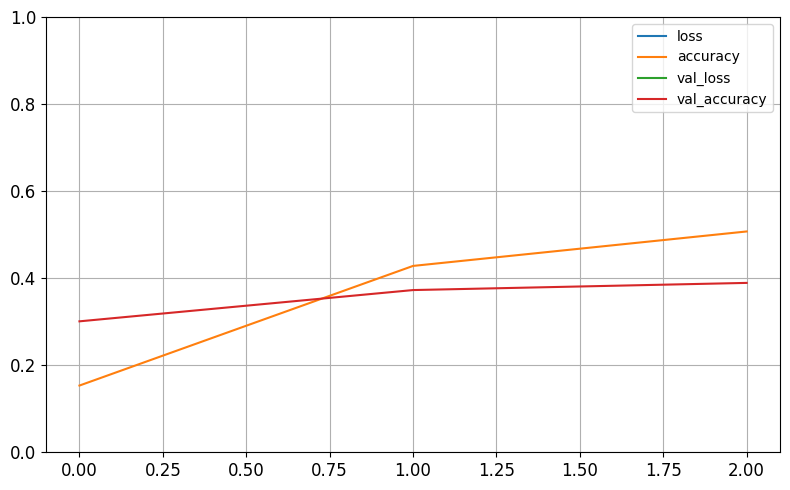

In [18]:
# Display the results of accuracy and loss from the validation set in graph plot
import pandas as pd

pd.DataFrame(history.history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
save_fig("keras_learning_curves_plot1")
plt.show()

## Generating Fake Text

In [19]:
log_probas = tf.math.log([[0.5, 0.4, 0.1]])  # probas = 50%, 40%, and 10%
tf.random.set_seed(42) # Generate random numbers and ensure reproducibility on CPU
tf.random.categorical(log_probas, num_samples=8)  # draw 8 samples

<tf.Tensor: shape=(1, 8), dtype=int64, numpy=array([[0, 1, 0, 2, 1, 0, 0, 1]], dtype=int64)>

In [20]:
# A custom function to randomly generate next character 
def next_char(text, temperature=1):
    y_proba = my_script_model.predict([text])[0, -1:]
    rescaled_logits = tf.math.log(y_proba) / temperature
    char_id = tf.random.categorical(rescaled_logits, num_samples=1)[0, 0]
    return text_vec_layer.get_vocabulary()[char_id + 2]

In [21]:
# A custom function to randomly generate next 100 characters
def extend_text(text, n_chars, temperature=1):
    for _ in range(n_chars):
        text += next_char(text, temperature)
    return text

In [22]:
tf.random.set_seed(42) # Generate random numbers and ensure reproducibility on CPU

In [23]:
# Extend 10 characters with temperature at 100 for more random
n_chars10 = 10
print(extend_text("ที่", n_chars10, temperature=100))

NameError: name 'my_script_model' is not defined

In [ ]:
# Extend 50 characters with temperature at 1 for more random and less deterministic
n_chars50 = 50
print(extend_text("ที่", n_chars50, temperature=1)) 

In [ ]:
# Extend 100 characters with temperature at 0.01 for more deterministic
n_chars100 = 100
print(extend_text("ที่", n_chars100, temperature=0.01)) 

## Stateless RNN

In [ ]:
# Generate sequences of text based on input data using stateless RNN
stateless_model = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_tokens, output_dim=16),
    tf.keras.layers.GRU(128, return_sequences=True),
    tf.keras.layers.Dense(n_tokens, activation="softmax")
])

In [ ]:
# Configure the input shape for the stateless model.
stateless_model.build(tf.TensorShape([None, None]))

In [ ]:
# Set weights
stateless_model.set_weights(model.get_weights())

In [ ]:
# Creater a new sequential model to test stateless RNN
my_script_model2 = tf.keras.Sequential([
    text_vec_layer,
    tf.keras.layers.Lambda(lambda X: X - 2),  # no <PAD> or <UNK> tokens
    stateless_model
])

In [ ]:
# Tesing with new text "iP" and extend 50 characters
tf.random.set_seed(42) # Generate random numbers and ensure reproducibility on CPU
print(extend_text("ที่", n_chars50, temperature=0.1))

### Summary

The model is able to predict characters/tokens as expected. The lower temperature displays more deterministic characters and the higher temperature displays more random characters. The model used temperature at 0.01, 1 and 100.

Stateless RNN is used for this character RNN model due to its simpler sequence modeling tasks where short-term dependencies are sufficient for accurate predictions.